<a href="https://colab.research.google.com/github/cacheop/facemask-detection/blob/master/Training_a_face_mask_object_detector_using_Tensorflow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Training a face mask object detector using Tensorflow





## Colab Configs
####Tensorflow Object Detection API requires TF1. Here I make sure the version is good. Also verify that this Colab is utilizing GPU and High-RAM.

In [0]:
import tensorflow as tf
import os
from psutil import virtual_memory

print("Current Tensorflow version: ", tf.__version__)

if tf.__version__ != "1.14.0":
    !pip uninstall tensorflow
    !pip install tensorflow-gpu==1.14
    print("New Tensorflow installed: ", tf.__version__)
    print('Stopping RUNTIME! Please run again.')
    os.kill(os.getpid(), 9)

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
   raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
print(gpu_info)

ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

!pip freeze | grep tensor


Current Tensorflow version:  2.2.0
Uninstalling tensorflow-2.2.0:
  Would remove:
    /usr/local/bin/estimator_ckpt_converter
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.6/dist-packages/tensorflow-2.2.0.dist-info/*
    /usr/local/lib/python3.6/dist-packages/tensorflow/*
Proceed (y/n)? n
     |████████████████████████████████| 377.0MB 39kB/s 
     |████████████████████████████████| 491kB 44.8MB/s 
     |████████████████████████████████| 3.2MB 46.3MB/s 
ERROR: tensorflow 2.2.0 has requirement tensorboard<2.3.0,>=2.2.0, but you'll have tensorboard 1.14.0 which is incompatible.
ERROR: tensorflow 2.2.0 has requirement tensorflow-estimator<2.3.0,>=2.2.0, but you'll have tensorflow-estimator 1.14.0 which is incompatible.
  Found existing installation: tensorflow-estimator 2.2.0
    Uninstalling tensorflow-estimator-2.2.

## Mount Google Drive
####Mounting Google Drive filesystem 

In [0]:
from google.colab import drive
drive.mount('/content/drive')
!ln -s "/content/drive/My Drive/mask-detection/" "/content/mask-detection"
!cd /content/mask-detection/


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


## Pick base model 
Using `ssd_inception_v2_coco`

In [0]:
# Number of training steps.
num_steps = 105100

# Number of evaluation steps.
num_eval_steps = 73

MODELS_CONFIG = {
    'ssd_mobilenet_v2': {
        'model_name': 'ssd_mobilenet_v2_coco_2018_03_29',
        'pipeline_file': 'ssd_mobilenet_v2_coco.config',
        'batch_size': 12
    },
    'faster_rcnn_inception_v2': {
        'model_name': 'faster_rcnn_inception_v2_coco_2018_01_28',
        'pipeline_file': 'faster_rcnn_inception_v2_coco.config',
        'batch_size': 12
    },
    'ssd_inception_v2_coco': {
        'model_name': 'ssd_inception_v2_coco_2018_01_28',
        'pipeline_file': 'ssd_inception_v2_coco.config',
        'batch_size': 12
    }
}

# Pick the model you want to use
# Select a model in `MODELS_CONFIG`.
selected_model = 'ssd_inception_v2_coco'

# Name of the object detection model to use.
MODEL = MODELS_CONFIG[selected_model]['model_name']

# Name of the pipline file in tensorflow object detection API.
pipeline_file = MODELS_CONFIG[selected_model]['pipeline_file']

# Training batch size fits in Colabe's Tesla K80 GPU memory for selected model.
batch_size = MODELS_CONFIG[selected_model]['batch_size']

test_record_fname = '/content/mask-detection/data/annotations/test.record'
train_record_fname = '/content/mask-detection/data/annotations/train.record'
label_map_pbtxt_fname = '/content/mask-detection/data/annotations/label_map.pbtxt'

print('Selected model: ', MODEL)
pipeline_file

Selected model:  ssd_inception_v2_coco_2018_01_28


'ssd_inception_v2_coco.config'

## Install required packages

In [0]:
root_dir = '/content/mask-detection'
%cd {root_dir}

!git clone https://github.com/tensorflow/models.git
!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk
!pip install -q numpy==1.17.4 pillow lxml Cython jupyter matplotlib pandas opencv-python contextlib2 lxml pycocotools xmltodict

/content/drive/My Drive/mask-detection
Selecting previously unselected package python-bs4.
(Reading database ... 144467 files and directories currently installed.)
Preparing to unpack .../0-python-bs4_4.6.0-1_all.deb ...
Unpacking python-bs4 (4.6.0-1) ...
Selecting previously unselected package python-pkg-resources.
Preparing to unpack .../1-python-pkg-resources_39.0.1-2_all.deb ...
Unpacking python-pkg-resources (39.0.1-2) ...
Selecting previously unselected package python-chardet.
Preparing to unpack .../2-python-chardet_3.0.4-1_all.deb ...
Unpacking python-chardet (3.0.4-1) ...
Selecting previously unselected package python-six.
Preparing to unpack .../3-python-six_1.11.0-2_all.deb ...
Unpacking python-six (1.11.0-2) ...
Selecting previously unselected package python-webencodings.
Preparing to unpack .../4-python-webencodings_0.5-2_all.deb ...
Unpacking python-webencodings (0.5-2) ...
Selecting previously unselected package python-html5lib.
Preparing to unpack .../5-python-html5lib_

###Here we build the APIs

In [0]:
%cd /content/mask-detection/models/research
!python setup.py build
!python setup.py install

%cd /content/mask-detection/models/research/slim
!python3 setup.py build
!python3 setup.py install

/content/drive/My Drive/mask-detection/models/research
running build
running build_py
copying object_detection/protos/anchor_generator_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_predictor_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/faster_rcnn_box_coder_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/calibration_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/argmax_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/flexible_grid_anchor_generator_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/graph_rewriter_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/bipartite_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/eval_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/faster_rcnn_pb2.py -> build/lib/object_detection/

### Set path for the files built above and compile with Google protobuf. Then we import the Object Detection code to make sure it's available.

In [0]:
import sys

sys.path.append("/content/mask-detection/models/")
sys.path.append("/content/mask-detection/models/research/")
sys.path.append("/content/mask-detection/models/research/slim")
sys.path.append("/content/mask-detection/models/research/object_detection")
sys.path.append("/usr/local/lib/python3.6/dist-packages/tensorflow/contrib")
sys.path.append("/usr/local/lib/python3.6/dist-packages/tensorflow/contrib/slim")
sys.path.append("/usr/local/lib/python3.6/dist-packages/tensorflow/contrib/proto")


%cd /content/mask-detection/models/research
!protoc --version
!protoc ./object_detection/protos/*.proto --python_out=.

/content/drive/My Drive/mask-detection/models/research
libprotoc 3.0.0
object_detection/protos/input_reader.proto: warning: Import object_detection/protos/image_resizer.proto but not used.


In [0]:
%cd /content/mask-detection/models/research/object_detection

# Testing Object Detection works
from tensorflow.contrib import slim
from nets import inception_resnet_v2
from object_detection.builders import model_builder
from object_detection.protos import input_reader_pb2
print("Object Detection code installed")

/content/drive/My Drive/mask-detection/models/research/object_detection
Object Detection code installed


## Download base model

In [0]:
%cd /content/mask-detection/models/research

import os
import shutil
import glob
import urllib.request
import tarfile
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = '/content/mask-detection/models/research/pretrained_model'

if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
os.rename(MODEL, DEST_DIR)

/content/drive/My Drive/mask-detection/models/research


In [0]:
DEST_DIR = '/content/mask-detection/models/research/pretrained_model'
!echo {DEST_DIR}
!ls -alh {DEST_DIR}


/content/mask-detection/models/research/pretrained_model
total 197M
-rw------- 1 root root   77 Feb  1  2018 checkpoint
-rw------- 1 root root  98M Feb  1  2018 frozen_inference_graph.pb
-rw------- 1 root root  96M Feb  1  2018 model.ckpt.data-00000-of-00001
-rw------- 1 root root  18K Feb  1  2018 model.ckpt.index
-rw------- 1 root root 3.5M Feb  1  2018 model.ckpt.meta
-rw------- 1 root root 4.0K Feb  1  2018 pipeline.config
drwx------ 2 root root 4.0K Feb  1  2018 saved_model


## Configuring a Training Pipeline

In [0]:
import os
pipeline_fname = os.path.join('/content/mask-detection/models/research/object_detection/samples/configs/', pipeline_file)
print('pipeline_fname:', pipeline_fname)

assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)

fine_tune_checkpoint = os.path.join(DEST_DIR, "model.ckpt")
print('fine_tune_checkpoint:', fine_tune_checkpoint)

pipeline_fname: /content/mask-detection/models/research/object_detection/samples/configs/ssd_inception_v2_coco.config
fine_tune_checkpoint: /content/mask-detection/models/research/pretrained_model/model.ckpt


###Creating the config file with the proper parameters

In [0]:
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=3, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)

    print(label_map)
    print(categories)
    print(category_index)

    return len(category_index.keys())

In [0]:
#In case I decided to re-train with different mumber of steps
num_steps = 105100

import re

num_classes = get_num_classes(label_map_pbtxt_fname)

with open(pipeline_fname) as f:
    s = f.read()
with open(pipeline_fname, 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(train.record)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(val.record)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    f.write(s)

!cat {pipeline_fname}

item {
  name: "good"
  id: 1
  display_name: "Mask"
}
item {
  name: "bad"
  id: 2
  display_name: "No mask"
}
item {
  name: "none"
  id: 3
  display_name: "Incorrect mask"
}

[{'id': 1, 'name': 'Mask'}, {'id': 2, 'name': 'No mask'}, {'id': 3, 'name': 'Incorrect mask'}]
{1: {'id': 1, 'name': 'Mask'}, 2: {'id': 2, 'name': 'No mask'}, 3: {'id': 3, 'name': 'Incorrect mask'}}
# SSD with Inception v2 configuration for MSCOCO Dataset.
# Users should configure the fine_tune_checkpoint field in the train config as
# well as the label_map_path and input_path fields in the train_input_reader and
# eval_input_reader. Search for "PATH_TO_BE_CONFIGURED" to find the fields that
# should be configured.

model {
  ssd {
    num_classes: 3
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        i

###Set training folder. 

In [0]:
model_dir = '/content/mask-detection/training/'
# Optionally remove content in output model directory to fresh start.
#!rm -rf {model_dir}
#os.makedirs(model_dir, exist_ok=True)

## Run Tensorboard

In [0]:
import datetime, os
import pkg_resources

for entry_point in pkg_resources.iter_entry_points('tensorboard_plugins'):
    print(entry_point.dist)

# Load the TensorBoard notebook extension
!pip uninstall tensorboard-plugin-wit

%load_ext tensorboard
%tensorboard --logdir {model_dir}  --host=127.0.0.1

tensorboard-plugin-wit 1.6.0.post3
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 438), started 0:00:16 ago. (Use '!kill 438' to kill it.)

## Train the model

In [0]:
print(num_steps)
print(num_eval_steps)

105100
73


In [0]:
!python /content/mask-detection/models/research/object_detection/model_main.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --num_eval_steps={num_eval_steps}

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

In [0]:
!ls {model_dir}

checkpoint
eval_0
events.out.tfevents.1591307012.4714f7d396ea
events.out.tfevents.1591313548.4714f7d396ea
events.out.tfevents.1591396096.4af4600363a6
events.out.tfevents.1591464165.3792bbb71d0f
export
exported_graph
graph.pbtxt
model.ckpt-101232.data-00000-of-00001
model.ckpt-101232.index
model.ckpt-101232.meta
model.ckpt-102513.data-00000-of-00001
model.ckpt-102513.index
model.ckpt-102513.meta
model.ckpt-103859.data-00000-of-00001
model.ckpt-103859.index
model.ckpt-103859.meta
model.ckpt-105000.data-00000-of-00001
model.ckpt-105000.index
model.ckpt-105000.meta
model.ckpt-105100.data-00000-of-00001
model.ckpt-105100.index
model.ckpt-105100.meta


## Exporting a Trained Inference Graph
Once your training job is complete, you need to extract the newly trained inference graph, which will be later used to perform the object detection. This can be done as follows:

### Fetch last checkpoint

In [0]:
import re
import numpy as np

output_directory = '/content/mask-detection/exported_graph'
output_file = output_directory + '/frozen_inference_graph.pb'

lst = os.listdir(model_dir)
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join(model_dir, last_model)
print(last_model_path)

/content/mask-detection/training/model.ckpt-105100


### Use `export_inference_graph` program

In [0]:
%cd /content/mask-detection/models/research/
output_directory = '/content/mask-detection/training/exported_graph'

!python object_detection/export_inference_graph.py \
    --input_type image_tensor \
    --pipeline_config_path {pipeline_fname} \
    --trained_checkpoint_prefix {last_model_path} \
    --output_directory /content/mask-detection/training/exported_graph \

print("\n---\nDone exporting frozen graph")

/content/drive/My Drive/mask-detection/models/research
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framew

In [0]:
pb_fname = '/content/mask-detection/training/exported_graph/frozen_inference_graph.pb'
!ls -alh {pb_fname}
pipeline_fname

-rw------- 1 root root 53M Jun  6 17:26 /content/mask-detection/training/exported_graph/frozen_inference_graph.pb


'/content/mask-detection/models/research/object_detection/samples/configs/ssd_inception_v2_coco.config'

## Export to TFLite


In [0]:
%cd /content/mask-detection/models/research/

!python object_detection/export_tflite_ssd_graph.py \
--pipeline_config_path={pipeline_fname} \
--trained_checkpoint_prefix={last_model_path} \
--output_directory  /content/mask-detection/tflite \
--add_postprocessing_op=true

print("Exported to TFlite")
!ls -la /content/mask-detection/tflite

/content/drive/My Drive/mask-detection/models/research
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framew

## Convert the frozen graph (tflite_graph.pb) created above to the to the TensorFlow Lite flatbuffer format (detect.tflite)


In [0]:
%cd /content/mask-detection/models/research/

!tflite_convert --graph_def_file=/content/mask-detection/tflite/tflite_graph.pb --output_file=/content/mask-detection/tflite/detect.tflite --output_format=TFLITE --input_shapes=1,300,300,3 --input_arrays=normalized_input_image_tensor --output_arrays='TFLite_Detection_PostProcess','TFLite_Detection_PostProcess:1','TFLite_Detection_PostProcess:2','TFLite_Detection_PostProcess:3' --allow_custom_ops #--inference_type=QUANTIZED_UINT8 --mean_values=128 --std_dev_values=127 --change_concat_input_ranges=false --allow_custom_ops


/content/drive/My Drive/mask-detection/models/research
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framew

## Run inference test
Test with images in repository `object_detection_demo/test` directory.

In [0]:
import os
import glob
import pathlib
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname
print('PATH_TO_CKPT', PATH_TO_CKPT)


# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname
print('PATH_TO_LABELS', PATH_TO_LABELS)


# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('/content/mask-detection/face_mask_detection/data/test/images')
print('PATH_TO_TEST_IMAGES_DIR', PATH_TO_TEST_IMAGES_DIR)
TEST_IMAGE_PATHS = ""


TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
print('TEST_IMAGE_PATHS', TEST_IMAGE_PATHS)

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)


Instructions for updating:
non-resource variables are not supported in the long term
PATH_TO_CKPT /content/mask-detection/training/exported_graph/frozen_inference_graph.pb
PATH_TO_LABELS /content/mask-detection/data/annotations/label_map.pbtxt
PATH_TO_TEST_IMAGES_DIR /content/mask-detection/face_mask_detection/data/test/images
TEST_IMAGE_PATHS [PosixPath('/content/mask-detection/face_mask_detection/data/test/images/990_Concern-In-China-As-Mystery-Virus-Spreads.jpg'), PosixPath('/content/mask-detection/face_mask_detection/data/test/images/HTB1ZfIrQVXXXXaEXVXXq6xXFXXXy.jpg_q50.jpg'), PosixPath('/content/mask-detection/face_mask_detection/data/test/images/IMG_9147.jpg'), PosixPath('/content/mask-detection/face_mask_detection/data/test/images/LondonChineseny260120-3.jpg'), PosixPath('/content/mask-detection/face_mask_detection/data/test/images/Nose_exposed_N95_grande.jpg'), PosixPath('/content/mask-detection/face_mask_detection/data/test/images/b3907fd44a737877c847748438b72de9size_1000x561

In [0]:
def load_graph(graph_file):
    graph = tf.Graph()
    with graph.as_default():
        od_graph_def = tf.GraphDef()
        with tf.gfile.GFile(graph_file, 'rb') as fid:
            serialized_graph = fid.read()
            od_graph_def.ParseFromString(serialized_graph)
            tf.import_graph_def(od_graph_def, name='')
    return graph

In [0]:
%cd /content/mask-detection/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops

# This is needed to display the images.
%matplotlib inline

from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

detection_graph = load_graph(PATH_TO_CKPT)

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes = num_classes, use_display_name = True)
category_index = label_map_util.create_category_index(categories)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

/content/drive/My Drive/mask-detection/models/research/object_detection


In [0]:
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)
        
def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session(graph=detection_graph) as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}

            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                
                 ###    
                print('real_num_detection', real_num_detection)

                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate

            
            output_dict['num_detections'] = int(output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict['detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]

        
    return output_dict

In [0]:
#just some debugging function ignore this
def show_class_score(output_dict):
    print("\n=====================")
    for scores, classes in zip(output_dict['detection_scores'], output_dict['detection_classes']):
        print("Class: % 2d, Score : % 5.4f" %(classes, scores))

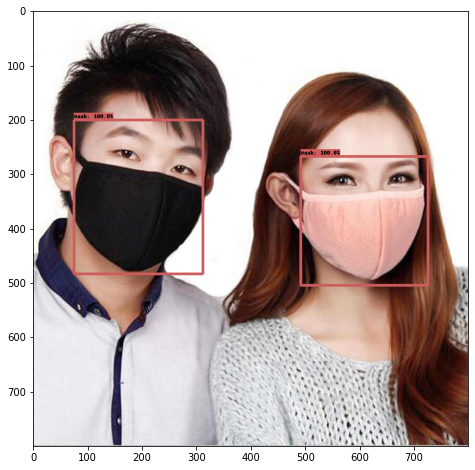

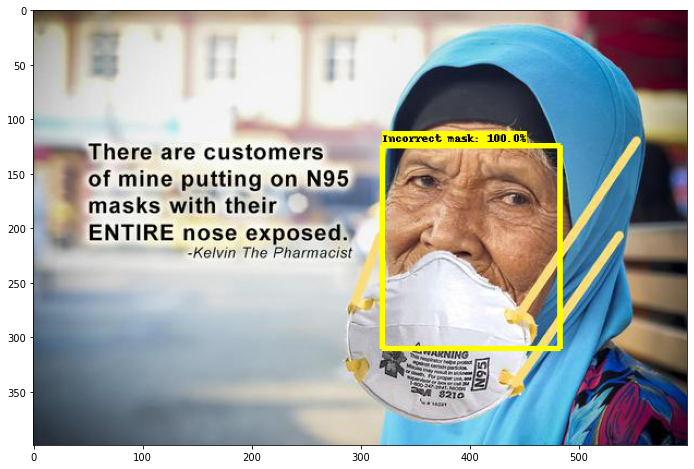

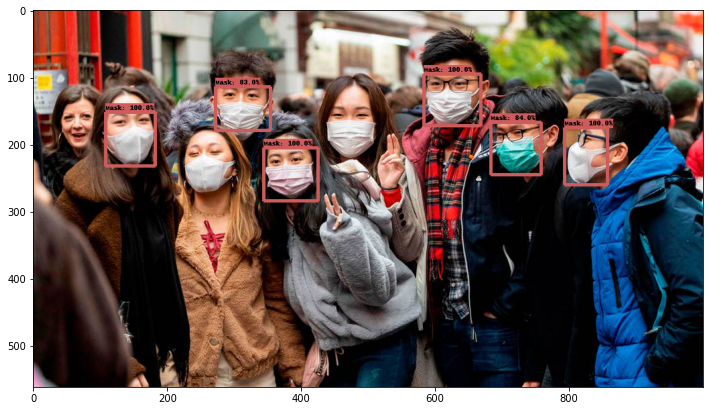

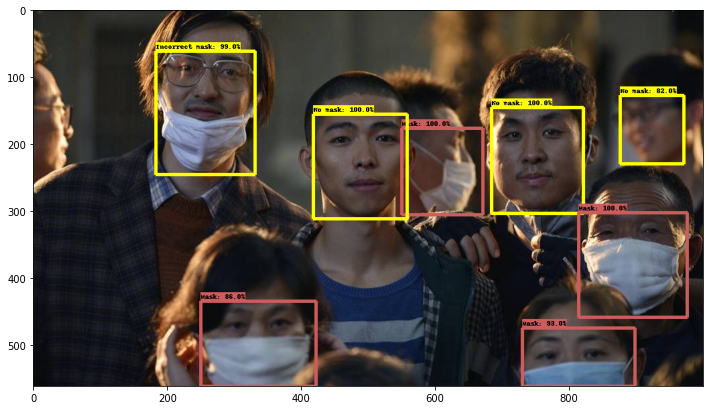

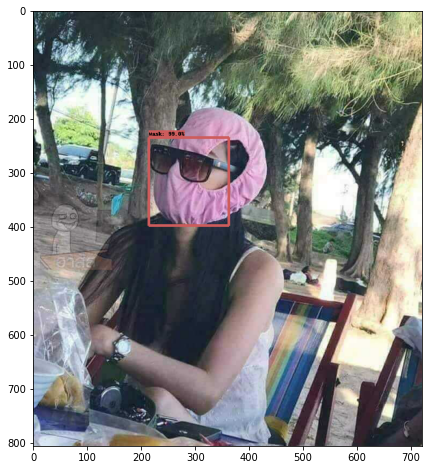

...

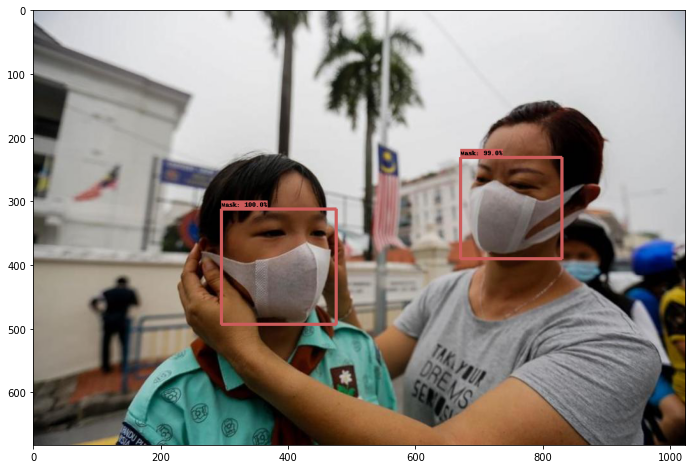

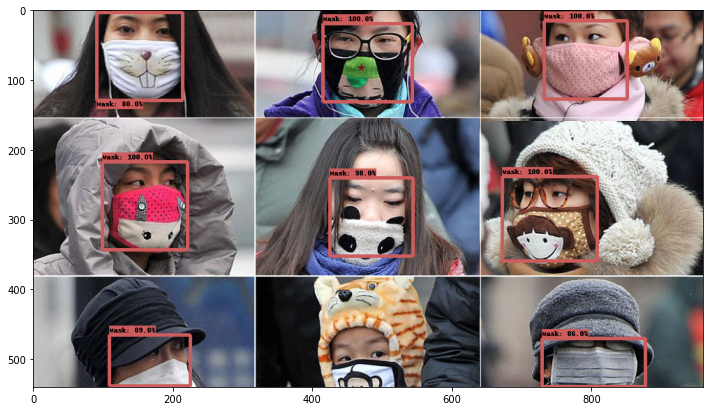

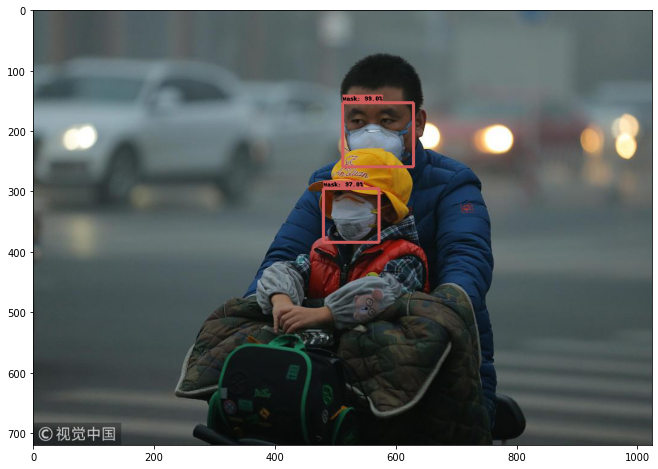

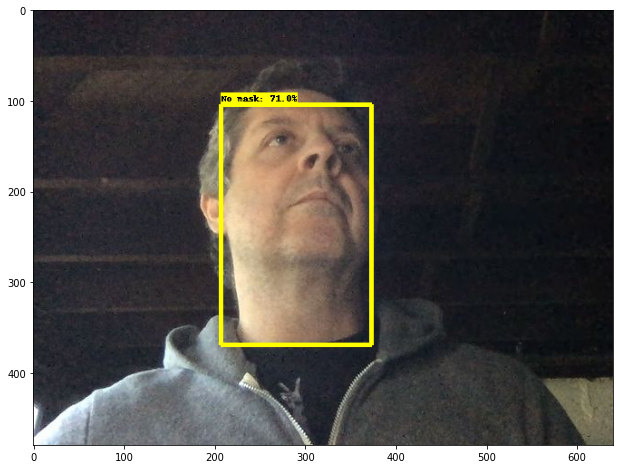

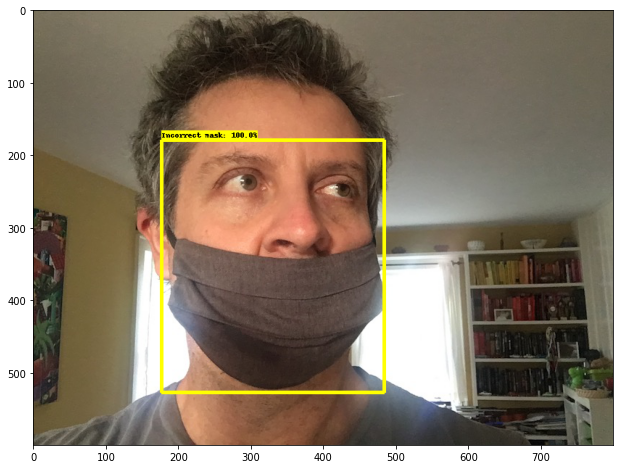

In [0]:
from PIL import Image

def run_inference_for_multiple_images(TEST_IMAGE_PATHS, detection_graph):
    for image_path in TEST_IMAGE_PATHS:
        image = Image.open(image_path)

        image_np = load_image_into_numpy_array(image)

        # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
        #image_np_expanded = np.expand_dims(image_np, axis=0)
        # Actual detection.
        output_dict = run_inference_for_single_image(image_np, detection_graph)
        #show_class_score(output_dict)
        # Visualization of the results of a detection.
        vis_util.visualize_boxes_and_labels_on_image_array(
            image_np,
            output_dict['detection_boxes'],
            output_dict['detection_classes'],
            output_dict['detection_scores'],
            category_index,
            instance_masks=output_dict.get('detection_masks'),
            use_normalized_coordinates=True,
            line_thickness=5, min_score_thresh=0.7)
        plt.figure(figsize=IMAGE_SIZE)
        plt.imshow(image_np)

run_inference_for_multiple_images(TEST_IMAGE_PATHS, detection_graph)
